# Data Inspection / Analysis

- mean
- std
- spatial covariance
- distribution

In [1]:
import numpy as np
import datetime as dt
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import xarray as xr
from aux.utils import calc_stat_moments

import dask
dask.config.set(scheduler='processes')

from dask.diagnostics import ProgressBar
#import link_src
from aux.plot import Map

In [2]:
era5 = xr.open_mfdataset('../data/hourly_for_animations/*precip*.nc')

In [3]:
era5.data_vars

Data variables:
    tp       (time, latitude, longitude) float32 dask.array<shape=(8760, 13, 53), chunksize=(744, 13, 53)>
    cp       (time, latitude, longitude) float32 dask.array<shape=(8760, 13, 53), chunksize=(744, 13, 53)>
    swvl1    (time, latitude, longitude) float32 dask.array<shape=(8760, 13, 53), chunksize=(744, 13, 53)>
    swvl2    (time, latitude, longitude) float32 dask.array<shape=(8760, 13, 53), chunksize=(744, 13, 53)>
    ro       (time, latitude, longitude) float32 dask.array<shape=(8760, 13, 53), chunksize=(744, 13, 53)>
    tcwv     (time, latitude, longitude) float32 dask.array<shape=(8760, 13, 53), chunksize=(744, 13, 53)>

## Projections
The `Map()` configuration object may be used with all cartopy CRS (coordinate reference system).
To plot a xarray.DataArray `xar`, just use `m.plot(xar)`. It returns matplotlib's figure and axis objects.

Example CRSs:
- ccrs.LambertConformal(central_longitude=0, central_latitude=0)
- ccrs.Orthographic(central_longitude=0, central_latitude=0)
- ccrs.PlateCarree()

In [47]:
m = Map(figure_kws=dict(figsize=(10,8)))

## Getting an overview over the dataset
### Mean, Std, Skewness, 1/99 percentile and distribution density plot

In [48]:
var = 'tp'
sm = calc_stat_moments(era5, dim_aggregator='time', time_constraint=None)

In [49]:
sm

<xarray.Dataset>
Dimensions:       (latitude: 13, longitude: 53, stat_moments: 3)
Coordinates:
  * longitude     (longitude) float32 7.0 7.25 7.5 7.75 ... 19.5 19.75 20.0
  * latitude      (latitude) float32 50.0 49.75 49.5 49.25 ... 47.5 47.25 47.0
  * stat_moments  (stat_moments) <U4 'mean' 'std' 'vc'
Data variables:
    tp            (stat_moments, latitude, longitude) float32 dask.array<shape=(3, 13, 53), chunksize=(1, 13, 53)>
    cp            (stat_moments, latitude, longitude) float32 dask.array<shape=(3, 13, 53), chunksize=(1, 13, 53)>
    swvl1         (stat_moments, latitude, longitude) float32 dask.array<shape=(3, 13, 53), chunksize=(1, 13, 53)>
    swvl2         (stat_moments, latitude, longitude) float32 dask.array<shape=(3, 13, 53), chunksize=(1, 13, 53)>
    ro            (stat_moments, latitude, longitude) float32 dask.array<shape=(3, 13, 53), chunksize=(1, 13, 53)>
    tcwv          (stat_moments, latitude, longitude) float32 dask.array<shape=(3, 13, 53), chunksize=(1

Text(0.5, 1.0, 'total precipitation - mean over time')

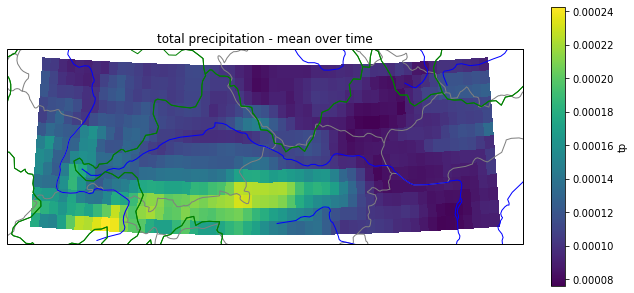

In [50]:
m.plot(sm['tp'].sel(stat_moments='mean'))
plt.title('total precipitation - mean over time')

Text(0.5, 1.0, 'total precipitation - std over time')

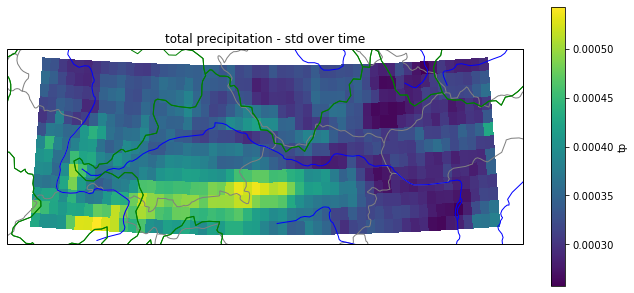

In [51]:
m.plot(sm['tp'].sel(stat_moments='std'))
plt.title('total precipitation - std over time')

Text(0.5, 1.0, 'total precipitation - coefficient of variation over time')

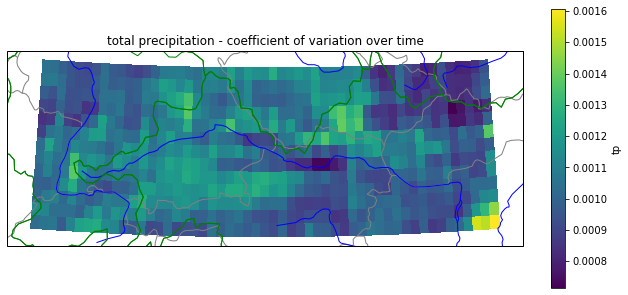

In [52]:
m.plot(sm['tp'].sel(stat_moments='vc'))
plt.title('total precipitation - coefficient of variation over time')

Text(0.5, 1.0, 'runoff - mean over time')

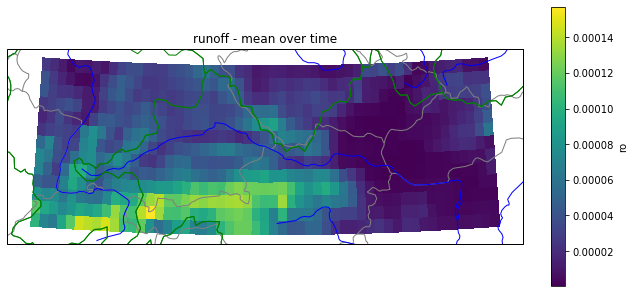

In [28]:
m.plot(sm['ro'].sel(stat_moments='mean'))
plt.title('runoff - mean over time')

Text(0.5, 1.0, 'runoff - std over time')

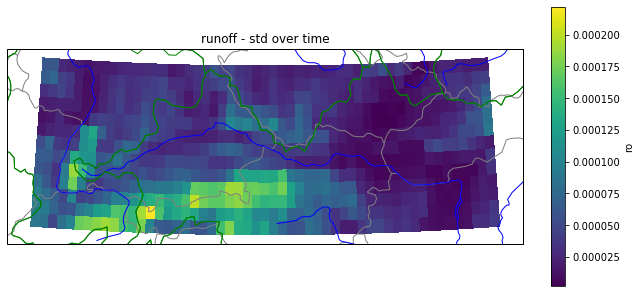

In [29]:
m.plot(sm['ro'].sel(stat_moments='std'))
plt.title('runoff - std over time')

Text(0.5, 1.0, 'runoff - coefficient of variation over time')

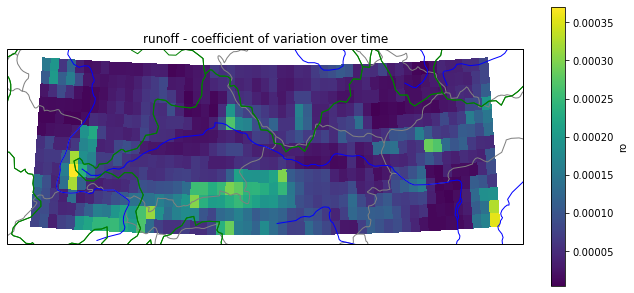

In [9]:
m.plot(sm['ro'].sel(stat_moments='vc'))
plt.title('runoff - coefficient of variation over time')

In [12]:
sm = calc_stat_moments(era5, dim_aggregator='spatial', time_constraint=None)

Text(0.5, 1.0, 'total precipitation - mean over lat/lon')

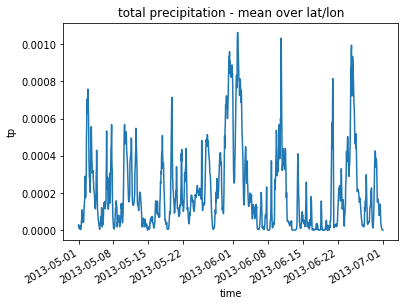

In [36]:
sm['tp'].sel(stat_moments='mean').sel(time=slice('2013-05', '2013-06')).plot()
plt.title('total precipitation - mean over lat/lon')

Text(0.5, 1.0, 'total precipitation - std over lat/lon')

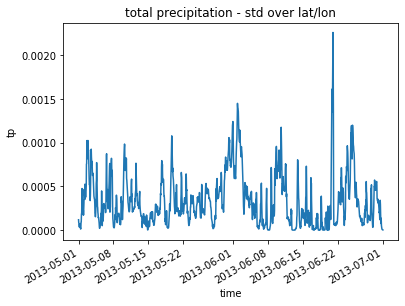

In [37]:
sm['tp'].sel(stat_moments='std').sel(time=slice('2013-05', '2013-06')).plot()
plt.title('total precipitation - std over lat/lon')

/home/srvx11/lehre/users/a1303583/.conda/envs/py3/lib/python3.7/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


Text(0.5, 1.0, 'total precipitation - coefficient of variation over lat/lon')

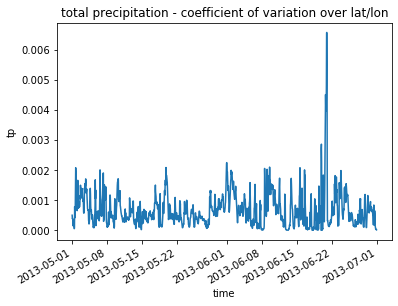

In [14]:
sm['tp'].sel(stat_moments='vc').sel(time=slice('2013-05', '2013-06')).plot()
plt.title('total precipitation - coefficient of variation over lat/lon')

Text(0.5, 1.0, 'runoff - mean over lat/lon')

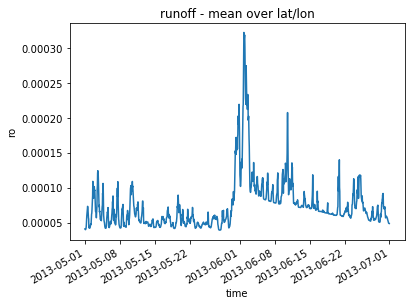

In [38]:
sm['ro'].sel(stat_moments='mean').sel(time=slice('2013-05', '2013-06')).plot()
plt.title('runoff - mean over lat/lon')

Text(0.5, 1.0, 'runoff - std over lat/lon')

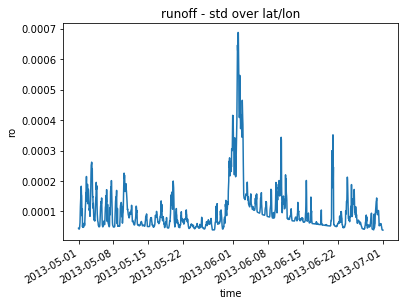

In [40]:
sm['ro'].sel(stat_moments='std').sel(time=slice('2013-05', '2013-06')).plot()
plt.title('runoff - std over lat/lon')

Text(0.5, 1.0, 'runoff - coefficient of variation over lat/lon')

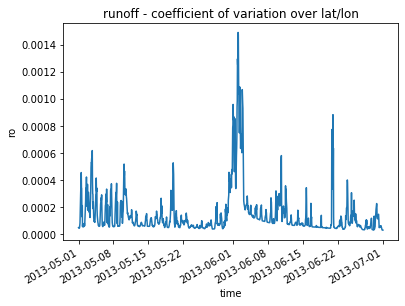

In [15]:
sm['ro'].sel(stat_moments='vc').sel(time=slice('2013-05', '2013-06')).plot()
plt.title('runoff - coefficient of variation over lat/lon')

## Spatial correlations

Text

In [54]:
anom = era5 - era5.mean('time')
da = anom[var]

Calling `xarray`'s plotting routines without projection yields nice plots too, but they may be distorted if your spatial domain is not of quadratic shape:

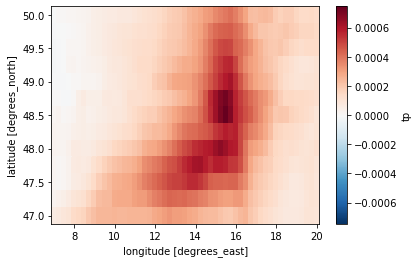

In [55]:
point = dict(latitude=48.5, longitude=15.5)
cov = da.loc[point].dot(da)
cov.plot.pcolormesh()

[########################################] | 100% Completed |  0.2s
[########################################] | 100% Completed |  0.2s


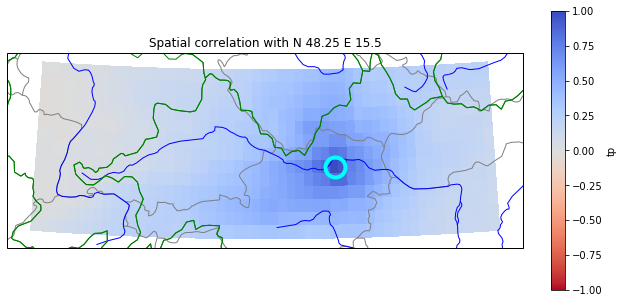

[########################################] | 100% Completed |  0.2s
[########################################] | 100% Completed |  0.2s


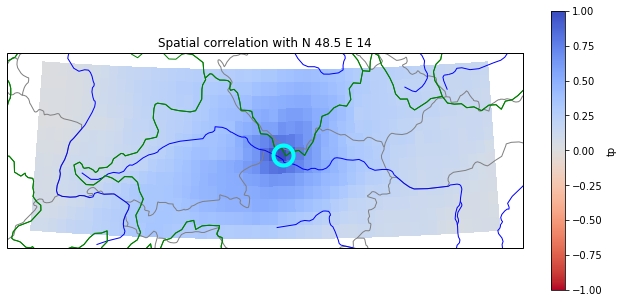

[########################################] | 100% Completed |  0.2s
[########################################] | 100% Completed |  0.2s


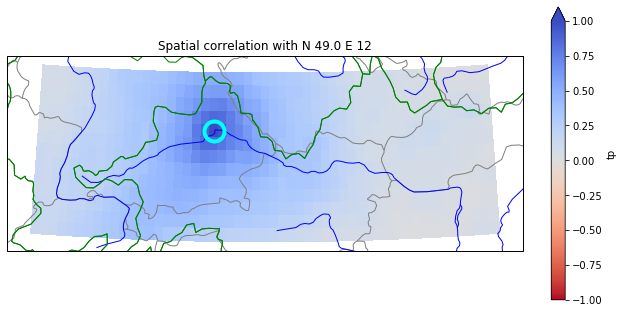

[########################################] | 100% Completed |  0.2s
[########################################] | 100% Completed |  0.2s


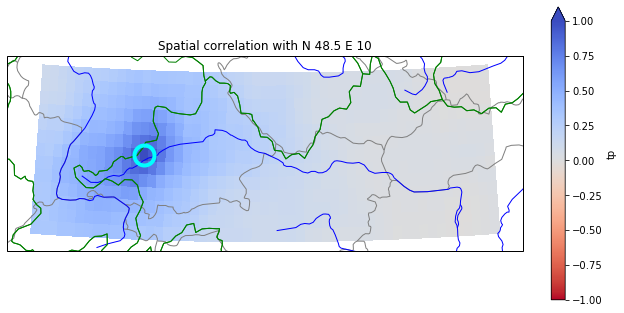

In [60]:
points = [dict(latitude=48.25, longitude=15.5),
          dict(latitude=48.5, longitude=14),
          dict(latitude=49., longitude=12),
          dict(latitude=48.5, longitude=10)
         ]

for point in points:
    cov = da.loc[point].dot(da)/(da.std('time')*da.loc[point].std('time'))/len(da.coords['time'])
    with ProgressBar():
        fig, ax = m.plot(cov, vmin=-1, vmax=1, cmap='coolwarm_r')
        m.plot_point(ax, lat=point['latitude'], lon=point['longitude'])
        ax.set_title(f"Spatial correlation with N {point['latitude']} E {point['longitude']}")
        plt.show()

# Dataset Variable's Distribution

using seaborn? or too many values ("big data")
-> probably "bokeh" module

In [ ]:
data = era5['lsp'].sum('time').values.ravel()
sb.distplot(data)

In [ ]:
data = era5['cp'].sum('time').values.ravel()
sb.distplot(data)

TypeError: inner() got multiple values for argument 'ax'

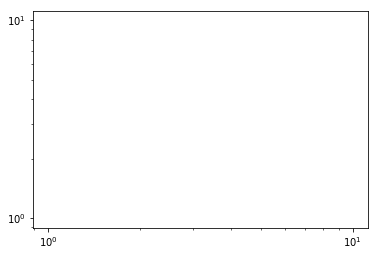

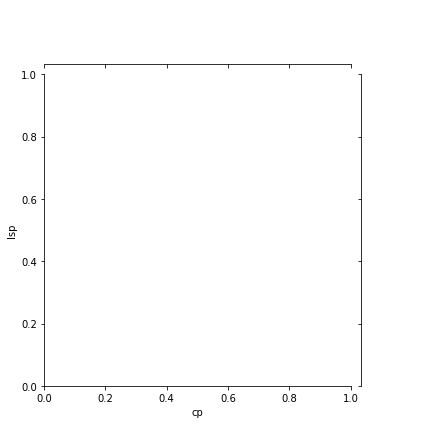

In [22]:
x, y = era5['cp'][0,:,:], xar['lsp'][0,:,:]

f, ax = plt.subplots()
ax.set(xscale="log", yscale="log")
mask = (x>0.001)*(y>0.001)
x, y = x.where(mask), y.where(mask)
sb.jointplot(x, y, ax=ax)

## Animations: How does a flooding event look in our data?

Let us define the time frame first. What timeframe could give us most insight into our data? 

Flooding event: May/June 2013

In [28]:
da = era5['tp']*1000
da.name = 'total_precipitation'
da = da.sel(time=slice(dt.datetime(2013,5,20), 
                       dt.datetime(2013,6,15)))

As we wont do heavy computations from now on, we can switch of parallelism and set the dask scheduler to `synchronous`. We can also load the data before rendering the animation.

In [29]:
dask.config.set(scheduler='synchronous')
da = da.load()

To avoid plotting colors where no or very little precipitation occured, let's grey out all values below 0.1 mm/day. As our dataset has precipitation in units of meters (per day), that is 0.001. So we set all values below this threshold to zero.

In [36]:
da = da.where(da>2, np.nan)

The next cell defines the code to create the animation, this is the place of choice if you want to customize your animation.

In [61]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
import xarray as xr


from matplotlib import animation, rc
from IPython.display import HTML

from aux.plot import choose_proj_from_xar
from aux.ml_flood_config import path_to_data

major_basins_shapefile = path_to_data+'/drainage_basins/Major_Basins_of_the_World.shp'


levels = [0.01, 0.1, 0.25, 0.50, 0.75, 1.0, 1.5, 2.0, 2.5, 3.0, 4.0, 5.0,
          6.0, 8.0, 10., 20.0]
nws_precip_colors = [
    "#04e9e7",  # 0.01 - 0.10 inches
    "#019ff4",  # 0.10 - 0.25 inches
    "#0300f4",  # 0.25 - 0.50 inches
    "#02fd02",  # 0.50 - 0.75 inches
    "#01c501",  # 0.75 - 1.00 inches
    "#008e00",  # 1.00 - 1.50 inches
    "#fdf802",  # 1.50 - 2.00 inches
    "#e5bc00",  # 2.00 - 2.50 inches
    "#fd9500",  # 2.50 - 3.00 inches
    "#fd0000",  # 3.00 - 4.00 inches
    "#d40000",  # 4.00 - 5.00 inches
    "#bc0000",  # 5.00 - 6.00 inches
    "#f800fd",  # 6.00 - 8.00 inches
    "#9854c6",  # 8.00 - 10.00 inches
    "#fdfdfd"   # 10.00+
]
precip_colormap = matplotlib.colors.ListedColormap(nws_precip_colors)


def create_animation(dataarray):
    da = dataarray
    fig, ax = plt.subplots(figsize=(12,8))
    proj = choose_proj_from_xar(da)
    ax = plt.axes(projection=proj)
    transform = ccrs.PlateCarree()

    countries = cfeature.NaturalEarthFeature(
                            category='cultural',
                            name='admin_0_boundary_lines_land',
                            scale='50m',
                            facecolor='none')
    rivers = cfeature.NaturalEarthFeature(scale='50m', category='physical',
                                          name='rivers_lake_centerlines', 
                                          edgecolor='blue', facecolor='none')

    ax.add_feature(countries, edgecolor='grey')
    ax.coastlines('50m')
    ax.add_feature(rivers, edgecolor='blue')

    sf = Reader(major_basins_shapefile)
    shape_feature = ShapelyFeature(sf.geometries(), transform, edgecolor='black')
    ax.add_feature(shape_feature, facecolor='none', edgecolor='green')

    im = (da.isel(time=0)*np.nan).plot.pcolormesh(ax=ax, transform=transform, 
                                                  subplot_kws=dict(projection=proj),
                                                  cbar_kwargs=dict(fraction=0.025), 
                                                  vmin=0, vmax=15,
                                                  #levels=levels,
                                                  cmap='ocean_r')
    def init():
        im.set_array(np.array([]))
        return im,

    def animate(i):
        data = da.isel(time=i)
        time = pd.to_datetime(data.time.values)
        title = str(data.name)+' - '+time.strftime('%Y-%m-%d %H')
        im.set_array(data.values.ravel())
        ax.set_title(title)
        return (im,)
    
    return animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(da.coords['time']), interval=100, 
                                   blit=True)

## Now it's time to render the video
When finished, you have multiple choices:
- Save your video to disk with `anim.save(filename)`
- Show it within this jupyter notebook 
    - as HTML5 Video (mp4) with `HTML(anim.to_html5_video())`
    - as Javascript Animation with `HTML(anim.to_jshtml())`
    
Note that github.com does not show your animations currently, but https://nbviewer.jupyter.org is an excellent site with lets you view all contents.

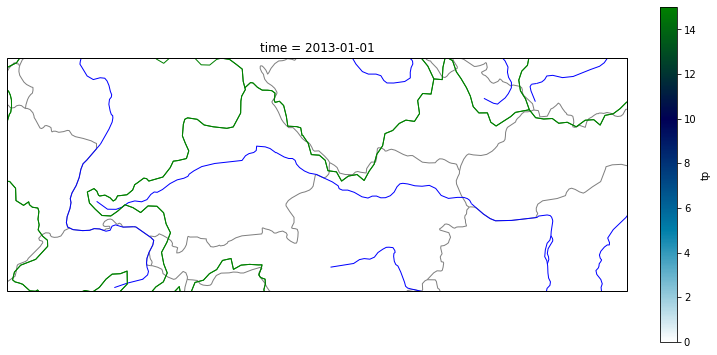

In [62]:
anim = create_animation(da)

In [63]:
HTML(anim.to_html5_video())

In [64]:
anim.save('tp_2013_05-06_hourly.mp4')

In [65]:
HTML(anim.to_jshtml())

Animation size has reached 20988507 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
